<h1>Optical Character Recogniton<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Environment-configuration" data-toc-modified-id="Environment-configuration-1">Environment configuration</a></span></li><li><span><a href="#Import-dependencies" data-toc-modified-id="Import-dependencies-2">Import dependencies</a></span></li><li><span><a href="#Load-data" data-toc-modified-id="Load-data-3">Load data</a></span></li><li><span><a href="#Adding-noise-to-images" data-toc-modified-id="Adding-noise-to-images-4">Adding noise to images</a></span><ul class="toc-item"><li><span><a href="#Salt-and-pepper-noise" data-toc-modified-id="Salt-and-pepper-noise-4.1">Salt and pepper noise</a></span></li><li><span><a href="#Gaussian-noise" data-toc-modified-id="Gaussian-noise-4.2">Gaussian noise</a></span></li></ul></li><li><span><a href="#Affine-transformations" data-toc-modified-id="Affine-transformations-5">Affine transformations</a></span><ul class="toc-item"><li><span><a href="#Rotations" data-toc-modified-id="Rotations-5.1">Rotations</a></span></li><li><span><a href="#Shearing" data-toc-modified-id="Shearing-5.2">Shearing</a></span><ul class="toc-item"><li><span><a href="#Horizontal-shear" data-toc-modified-id="Horizontal-shear-5.2.1">Horizontal shear</a></span></li><li><span><a href="#Vertical-shear" data-toc-modified-id="Vertical-shear-5.2.2">Vertical shear</a></span></li></ul></li></ul></li><li><span><a href="#Resize-image" data-toc-modified-id="Resize-image-6">Resize image</a></span><ul class="toc-item"><li><span><a href="#Downscale" data-toc-modified-id="Downscale-6.1">Downscale</a></span></li><li><span><a href="#Upscale" data-toc-modified-id="Upscale-6.2">Upscale</a></span></li></ul></li><li><span><a href="#Blur-the-image" data-toc-modified-id="Blur-the-image-7">Blur the image</a></span><ul class="toc-item"><li><span><a href="#Blur-with-average-filters-of-different-sizes" data-toc-modified-id="Blur-with-average-filters-of-different-sizes-7.1">Blur with average filters of different sizes</a></span></li><li><span><a href="#Blur-with-gaussian-filter" data-toc-modified-id="Blur-with-gaussian-filter-7.2">Blur with gaussian filter</a></span></li></ul></li><li><span><a href="#Text-retrieval-using-Pytesseract" data-toc-modified-id="Text-retrieval-using-Pytesseract-8">Text retrieval using Pytesseract</a></span></li><li><span><a href="#Evaluate-the-output" data-toc-modified-id="Evaluate-the-output-9">Evaluate the output</a></span><ul class="toc-item"><li><span><a href="#Correct-words-detection:-Spacy-lang-detection-+-some-nlp-processing-techniques" data-toc-modified-id="Correct-words-detection:-Spacy-lang-detection-+-some-nlp-processing-techniques-9.1">Correct words detection: Spacy lang detection + some nlp processing techniques</a></span></li><li><span><a href="#Correct-words-detection:-Pyspellchecker" data-toc-modified-id="Correct-words-detection:-Pyspellchecker-9.2">Correct words detection: Pyspellchecker</a></span></li><li><span><a href="#Comparing-Spacy-with-SpellChecker" data-toc-modified-id="Comparing-Spacy-with-SpellChecker-9.3">Comparing Spacy with SpellChecker</a></span></li></ul></li><li><span><a href="#Image-enhancement-processing-techniques" data-toc-modified-id="Image-enhancement-processing-techniques-10">Image enhancement processing techniques</a></span><ul class="toc-item"><li><span><a href="#Sharpening" data-toc-modified-id="Sharpening-10.1">Sharpening</a></span></li><li><span><a href="#Thresholding-techniques" data-toc-modified-id="Thresholding-techniques-10.2">Thresholding techniques</a></span></li><li><span><a href="#Morphological-operations" data-toc-modified-id="Morphological-operations-10.3">Morphological operations</a></span></li></ul></li><li><span><a href="#References" data-toc-modified-id="References-11">References</a></span></li></ul></div>

## Environment configuration

In [1]:
# !brew install tesseract
# !pip install pytesseract
# !pip install spacy_langdetect
# !python -m spacy download en
!pip install pyspellchecker

## Import dependencies

In [2]:
import matplotlib.image as img
import matplotlib.pyplot as plt
import os
import warnings
import numpy as np
import cv2
import random
import pytesseract
import re
import spacy

from spacy_langdetect import LanguageDetector
from spellchecker import SpellChecker
from collections import Counter

nlp = spacy.load('en')
nlp.add_pipe(LanguageDetector(), name='language_detector', last=True)

from nltk.tokenize import word_tokenize

warnings.filterwarnings("ignore")

## Load data

In [3]:
os.listdir('./sample_data')

['scanned_image_2.png',
 'scanned_image_3.jpg',
 'scanned_image_1.png',
 'dip_gw_1.jpg']

Shape:  (400, 720, 3)


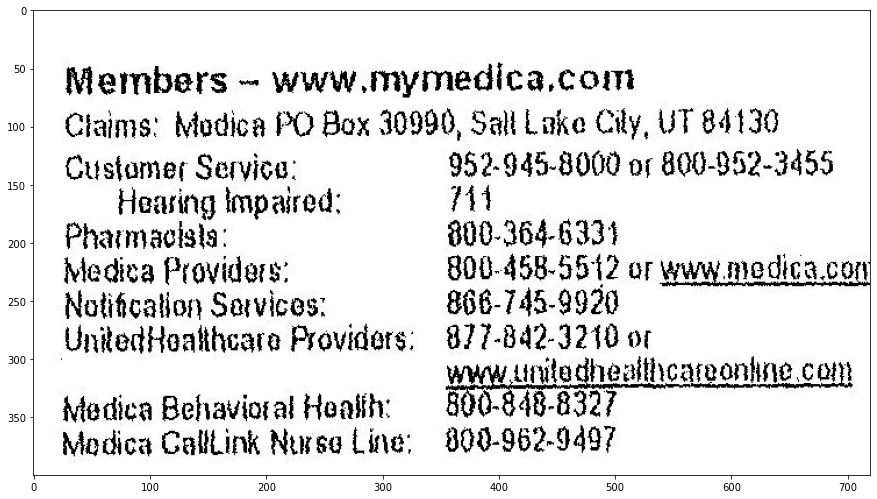

Shape:  (3459, 2430, 3)


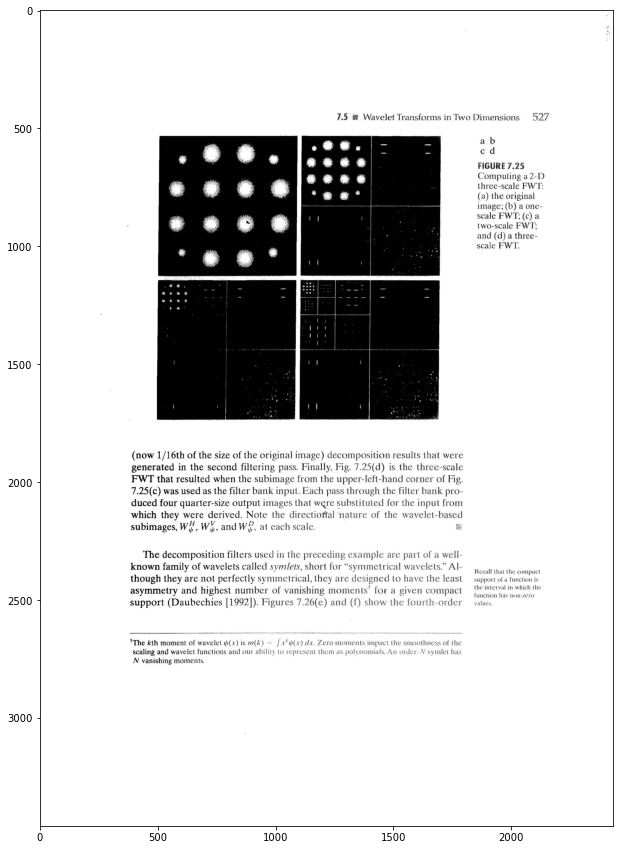

In [4]:
def see_test_image(filename):
    gray = cv2.imread(filename, 0)
    image = cv2.merge([gray, gray, gray])
    print('Shape: ', image.shape)

    fig = plt.figure(figsize=(15,15))
    plt.imshow(image)
    plt.show()
    
see_test_image('./sample_data/scanned_image_1.png')
see_test_image('./sample_data/dip_gw_1.jpg')

# see_test_image('./sample_data/scanned_image_2.png')
# see_test_image('./sample_data/scanned_image_3.jpg')

In [5]:
# get grayscale image
def get_grayscale(filename):
    image = img.imread(filename)
    image_grayscale = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return image # grayscale 1 value [0, 255] per pixel

def get_grayscale_rgb_format(filename):
    gray = cv2.imread(filename, 0)
    image = cv2.merge([gray, gray, gray])
    return image # grayscale in rgb format

In [6]:
def visualize_image(image, title=None):
    fig = plt.figure(figsize=(15,15))
    
    if len(list(image.shape)) == 2:
        image = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)
        
    plt.imshow(image)
    if title != None:
        plt.title(title, fontdict = {'fontsize' : 20})
    plt.show()

## Adding noise to images

### Salt and pepper noise

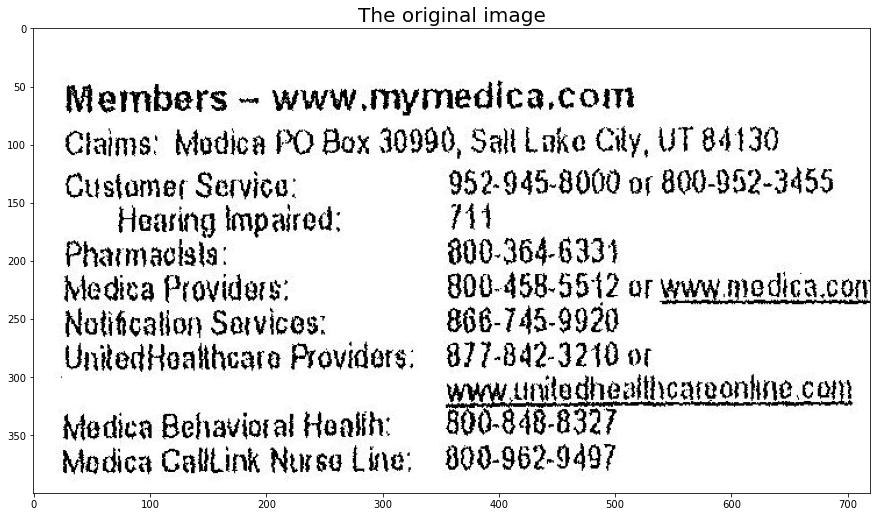

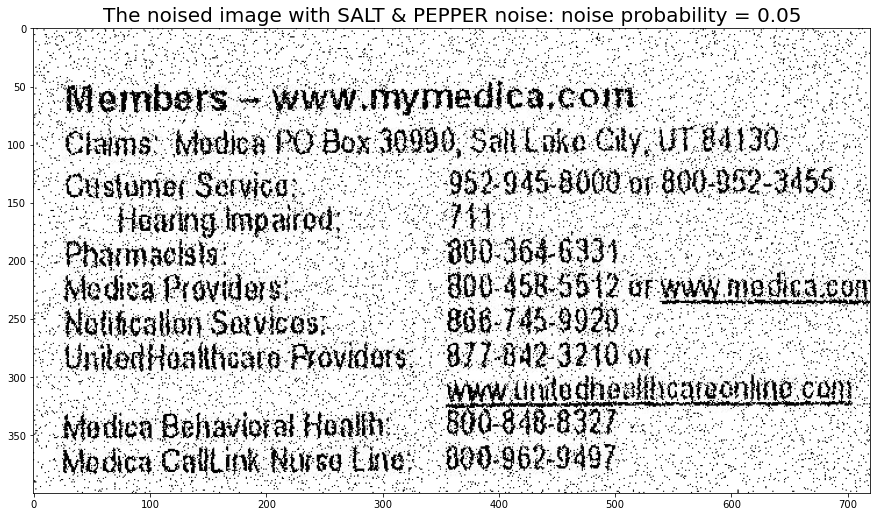

In [7]:
def sp_noise(image, noise_prob):
    '''
    Add salt and pepper noise to image
    prob: Probability of the noise
    '''
    output = np.zeros(image.shape, np.uint8)
    threshold = 1 - noise_prob 
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            random_chance = random.random()
            if random_chance < noise_prob:
                output[i][j] = 0
            elif random_chance > threshold:
                output[i][j] = 255
            else:
                output[i][j] = image[i][j]
    return output

def visualize_original_noised_in_comparison(filename, noise_prob):
    original_img = cv2.imread(filename, 0)
    noised = sp_noise(original_img, noise_prob)
    visualize_image(original_img, title='The original image')
    visualize_image(noised, title='The noised image with SALT & PEPPER noise: noise probability = ' + str(noise_prob))
    
visualize_original_noised_in_comparison(
    filename='./sample_data/scanned_image_1.png', 
    noise_prob=0.05)

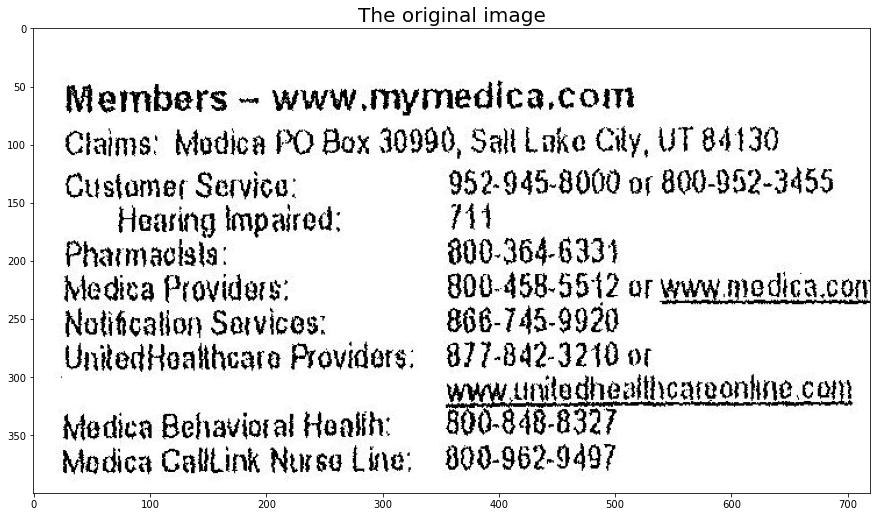

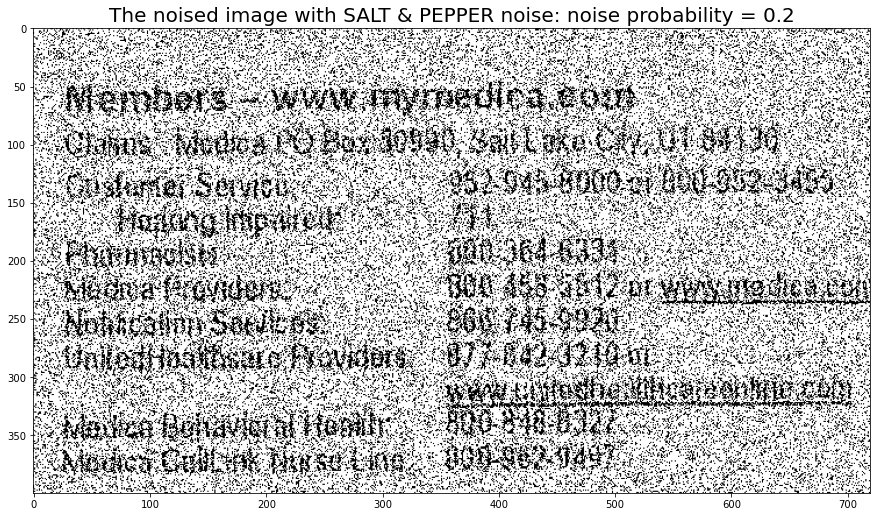

In [8]:
visualize_original_noised_in_comparison(
    filename='./sample_data/scanned_image_1.png', 
    noise_prob=0.2)

### Gaussian noise

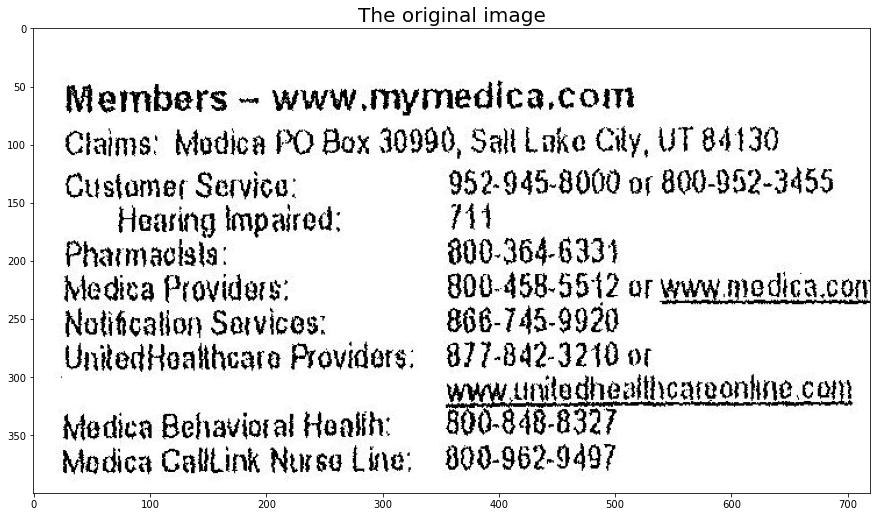

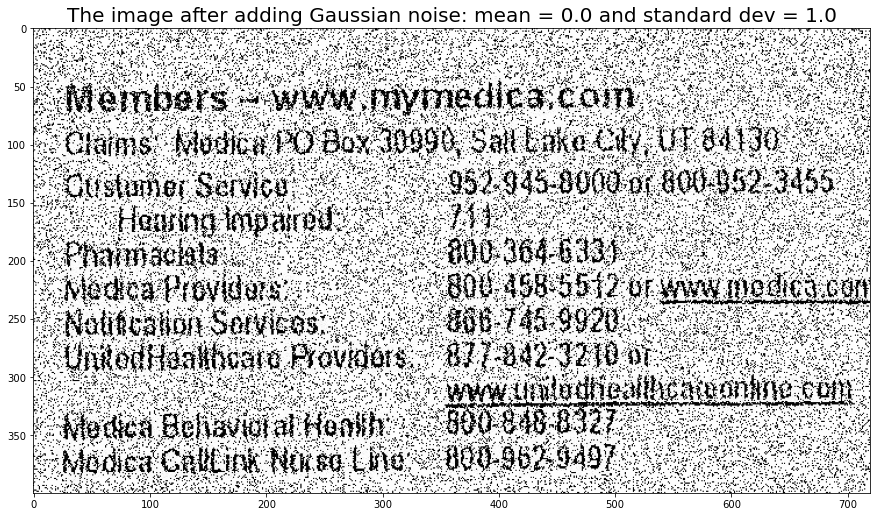

In [9]:
def add_gaussian_noise(original_image, mean, std):
    noisy_img = original_image + np.random.normal(mean, std, original_image.shape)
    return np.uint8(noisy_img)

def visualize_original_noised_in_comparison(filename, mean, std):
    original_img = cv2.imread(filename, 0)
    noised = add_gaussian_noise(original_img, mean, std)
    visualize_image(original_img, title='The original image')
    visualize_image(noised, title='The image after adding Gaussian noise: mean = ' + str(mean) + \
                   ' and standard dev = ' + str(std))
    
visualize_original_noised_in_comparison(
    filename='./sample_data/scanned_image_1.png', 
    mean=0.0,
    std=1.0)

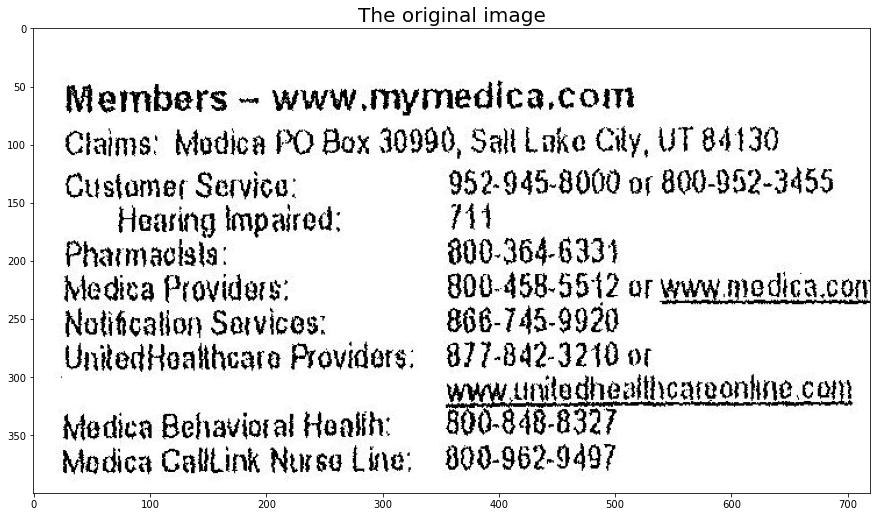

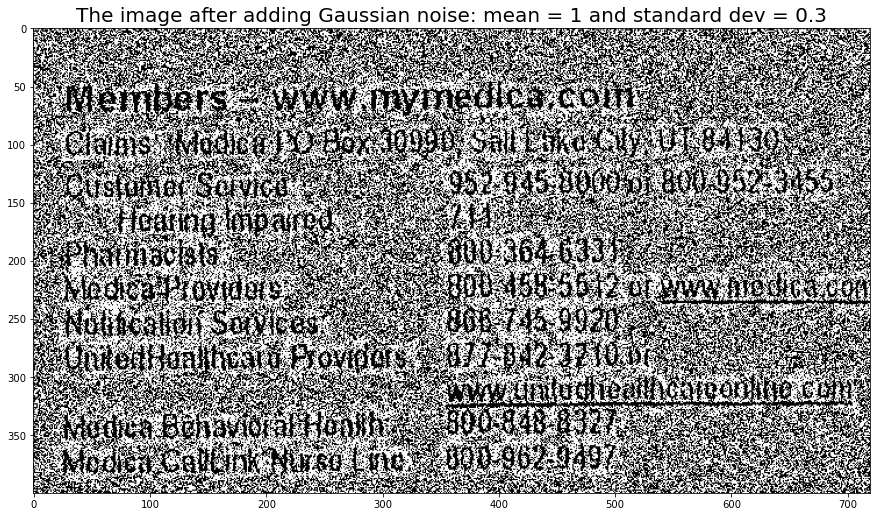

In [10]:
visualize_original_noised_in_comparison(
    filename='./sample_data/scanned_image_1.png', 
    mean=1,
    std=0.3)

## Affine transformations

### Rotations

![title](./filters_and_transf_matrix/rotation.png)

But **OpenCV** provides scaled rotation with adjustable center of rotation so that you can rotate at any location you prefer. Modified transformation matrix is given by:

![title](./filters_and_transf_matrix/rotation_opencv.png)

In [11]:
def rotate_image(original_img, angle):
    rows, cols = original_img.shape
    transformation_matrix = cv2.getRotationMatrix2D((cols / 2, rows / 2), angle, 1)
    rotated = cv2.warpAffine(original_img, transformation_matrix, (cols, rows))
    return rotated

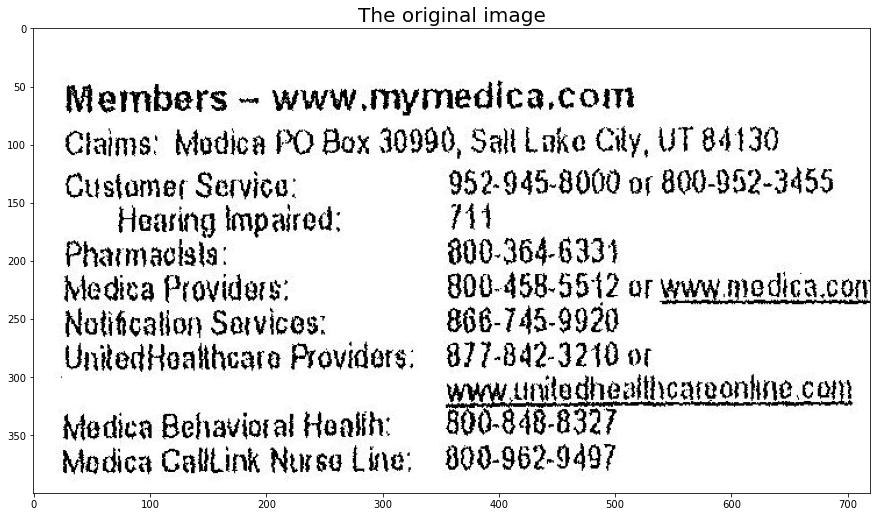

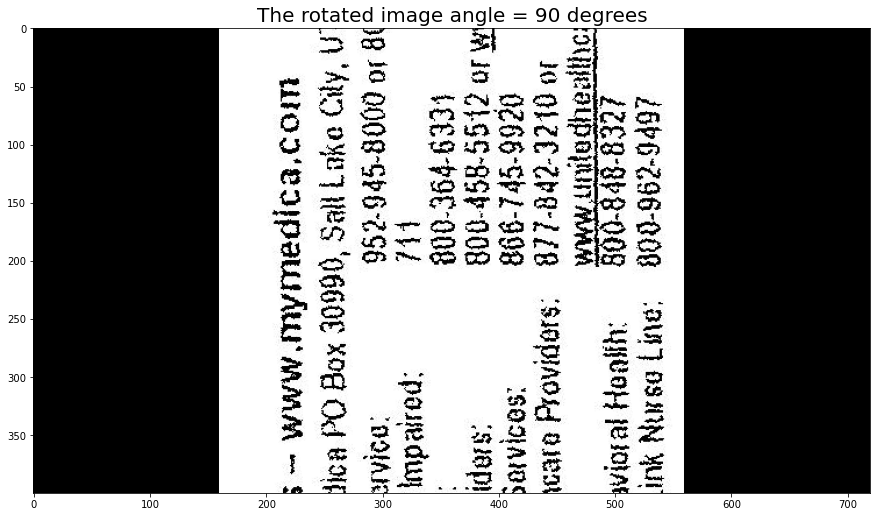

In [12]:
def visualize_original_rotated_in_comparison(filename, angle):
    original_img = cv2.imread(filename, 0)
    rotated = rotate_image(original_img, angle)
    visualize_image(original_img, title='The original image')
    visualize_image(rotated, title='The rotated image angle = ' + str(angle) + " degrees")
    
visualize_original_rotated_in_comparison('./sample_data/scanned_image_1.png', 90)

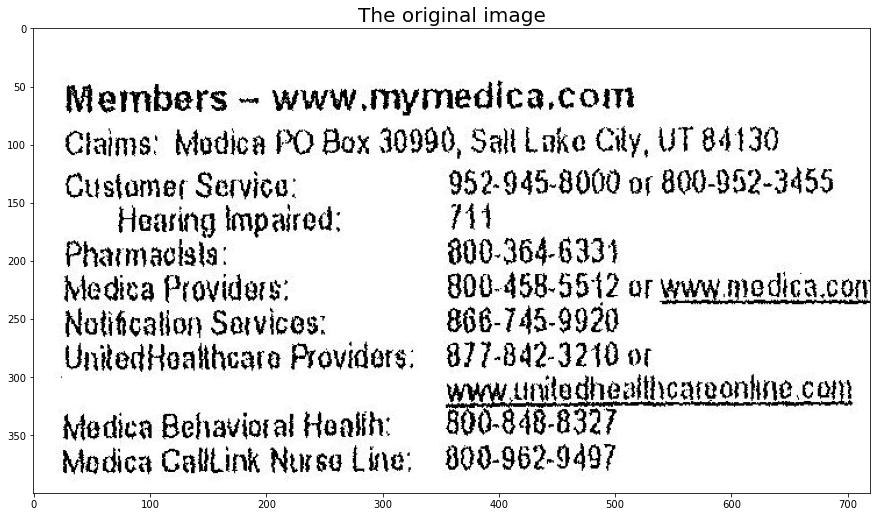

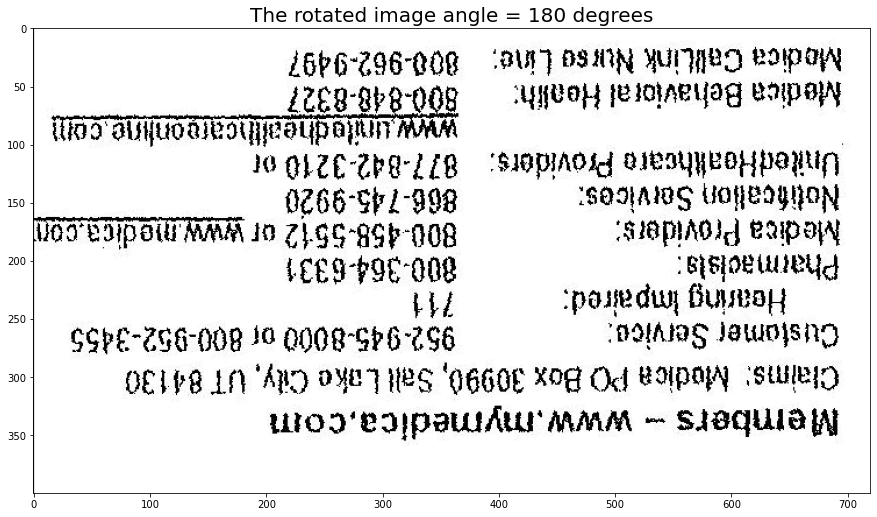

In [13]:
visualize_original_rotated_in_comparison('./sample_data/scanned_image_1.png', 180)

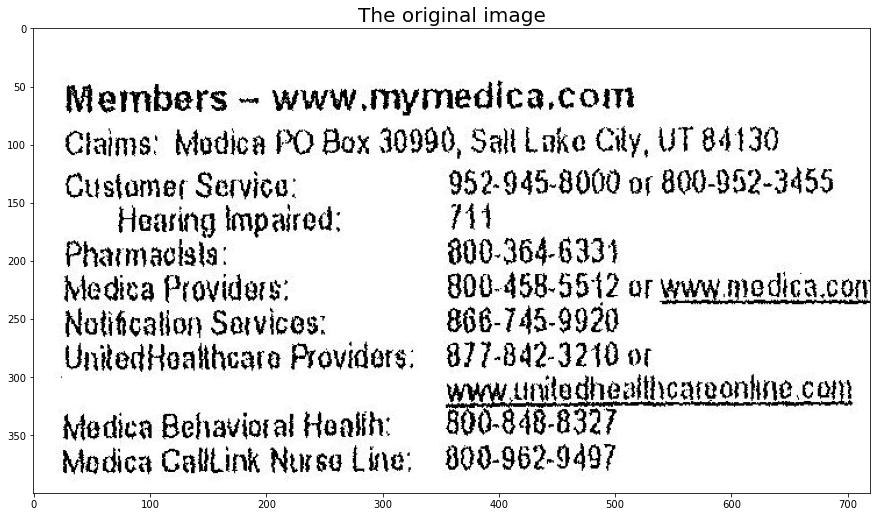

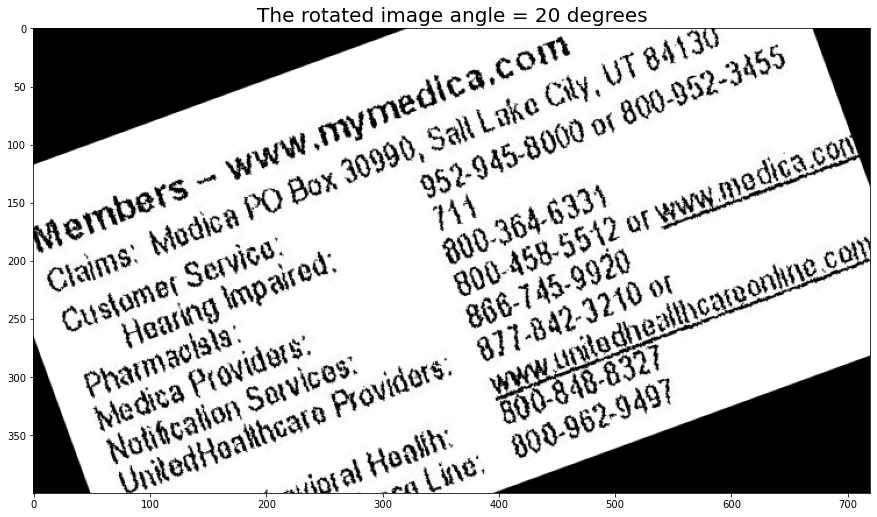

In [14]:
visualize_original_rotated_in_comparison('./sample_data/scanned_image_1.png', 20)

### Shearing

#### Horizontal shear

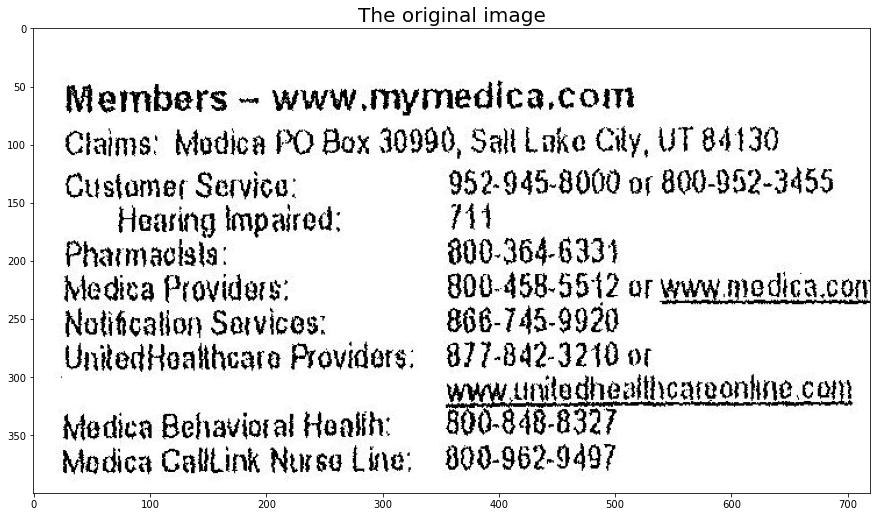

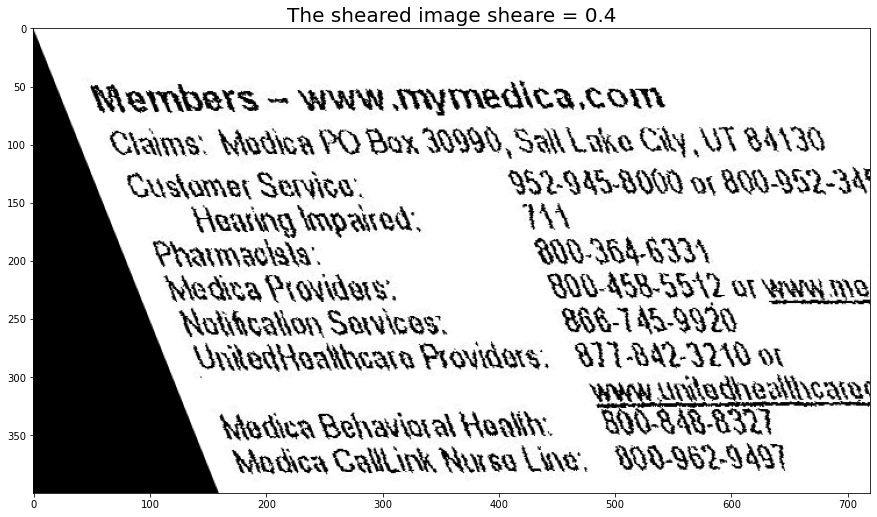

In [15]:
def horizontal_shear(original_img, shear):
    rows, cols = original_img.shape
    transformation_matrix = np.float32([[1, shear, 0], 
                                        [0, 1, 0]])
    sheared = cv2.warpAffine(original_img, transformation_matrix, (cols, rows))
    return sheared

def visualize_original_sheared_in_comparison(filename, shear_perc, shear_function):
    original_img = cv2.imread(filename, 0)
    sheared = shear_function(original_img, shear_perc)
    visualize_image(original_img, title='The original image')
    visualize_image(sheared, title='The sheared image sheare = ' + str(shear_perc))
    
visualize_original_sheared_in_comparison(
    filename='./sample_data/scanned_image_1.png',
    shear_perc=0.4,
    shear_function=horizontal_shear)

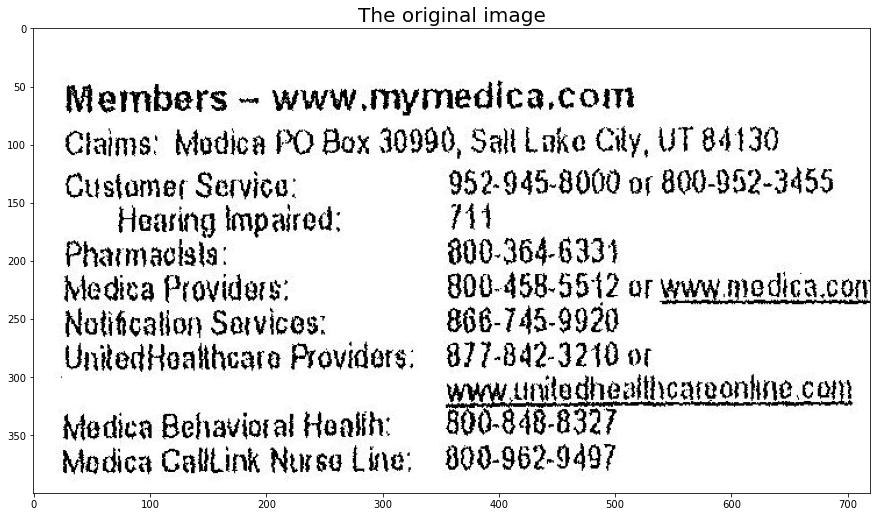

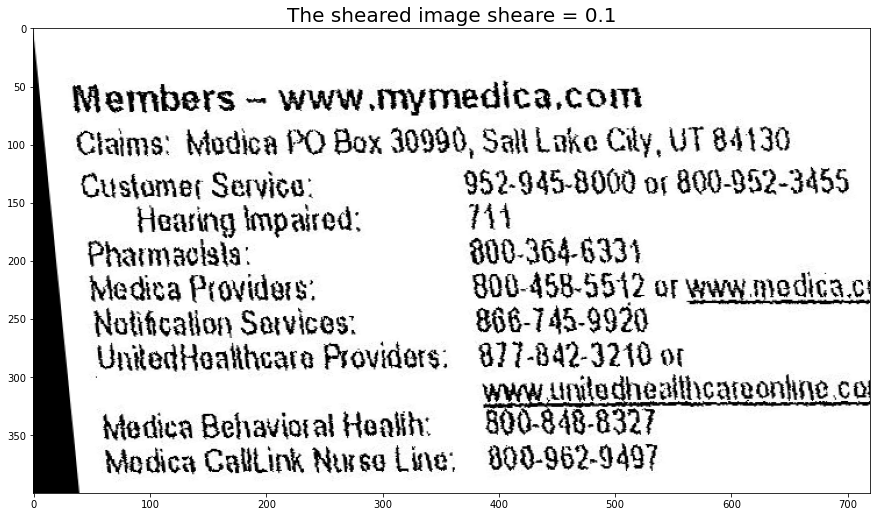

In [16]:
visualize_original_sheared_in_comparison(
    filename='./sample_data/scanned_image_1.png',
    shear_perc=0.1,
    shear_function=horizontal_shear)

#### Vertical shear

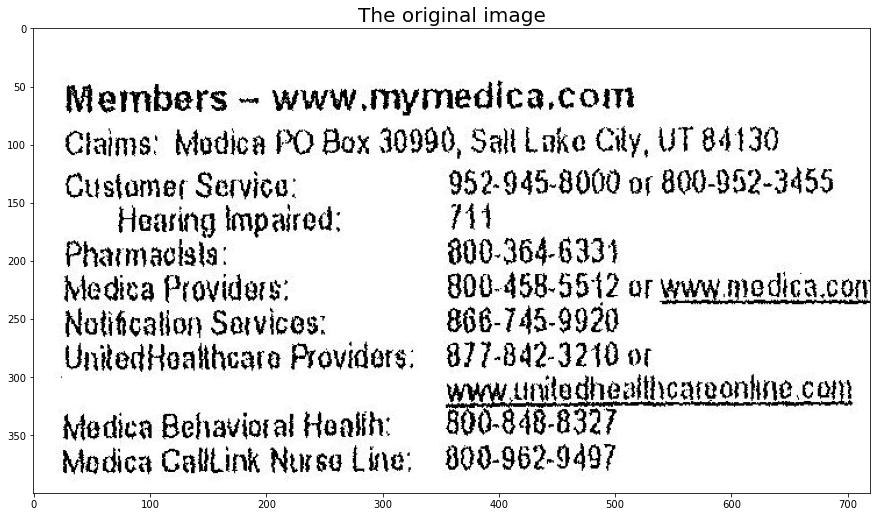

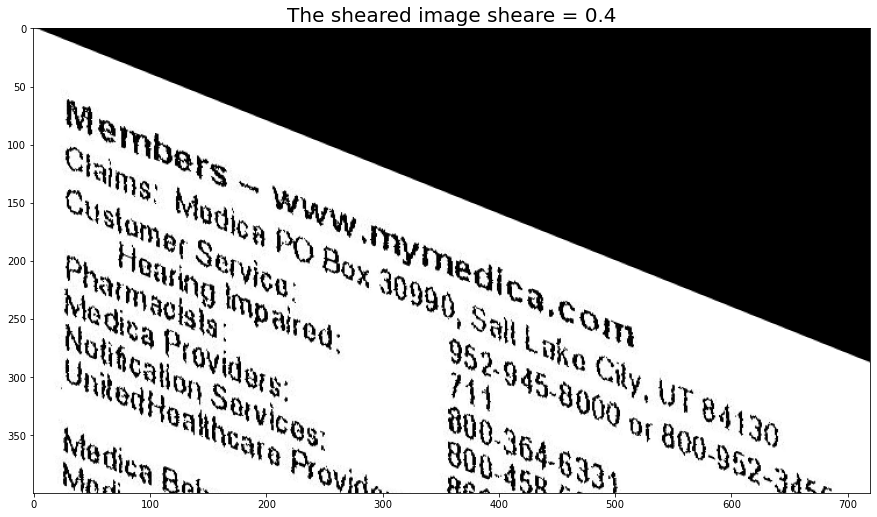

In [17]:
def verical_shear(original_img, shear):
    rows, cols = original_img.shape
    transformation_matrix = np.float32([[1, 0, 0], 
                                        [shear, 1, 0]])
    sheared = cv2.warpAffine(original_img, transformation_matrix, (cols, rows))
    return sheared

visualize_original_sheared_in_comparison(
    filename='./sample_data/scanned_image_1.png',
    shear_perc=0.4,
    shear_function=verical_shear)

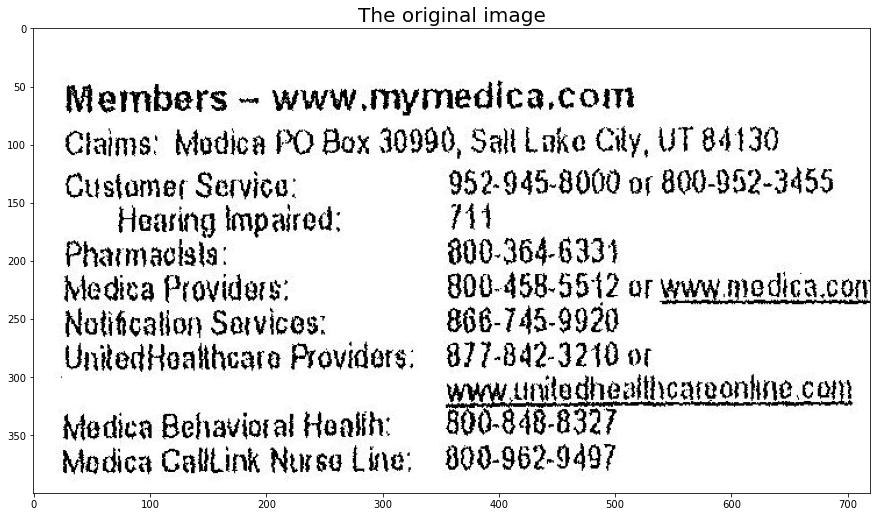

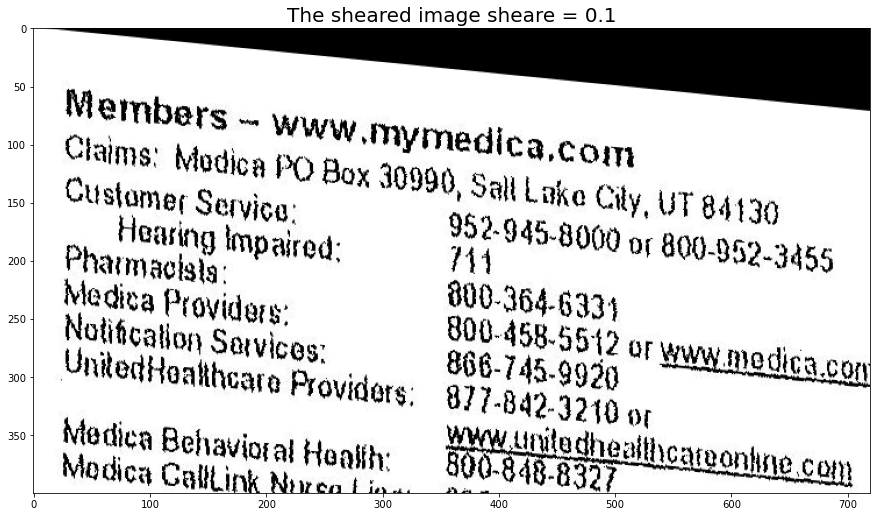

In [18]:
visualize_original_sheared_in_comparison(
    filename='./sample_data/scanned_image_1.png',
    shear_perc=0.1,
    shear_function=verical_shear)

## Resize image

I used **INTER_AREA** interpolation from OpenCV. This is more used for the upscaling process.

When we are enlarging an image with INTER_AREA, it is actually calling the bilinear function, but with a different way of calculating the interpolation coefficents.

For the **bilinear method**, assuming we consider a 1D image for simplicity, **the interpolated pixel value is a weighted average of the two original neighbourhood pixels**. The weights depend on the distances to the two pixels.

In [19]:
def resize_image(filename, scale_percent):
    img = cv2.imread(filename, cv2.IMREAD_UNCHANGED)
    print('Original Dimensions : ', img.shape)

    width = int(img.shape[1] * scale_percent / 100)
    height = int(img.shape[0] * scale_percent / 100)
    dim = (width, height)

    # resize image
    resized = cv2.resize(img, dim, interpolation = cv2.INTER_AREA)
    print('Resized Dimensions : ', resized.shape)
    
    return resized

### Downscale

Original Dimensions :  (400, 720, 4)
Resized Dimensions :  (240, 432, 4)


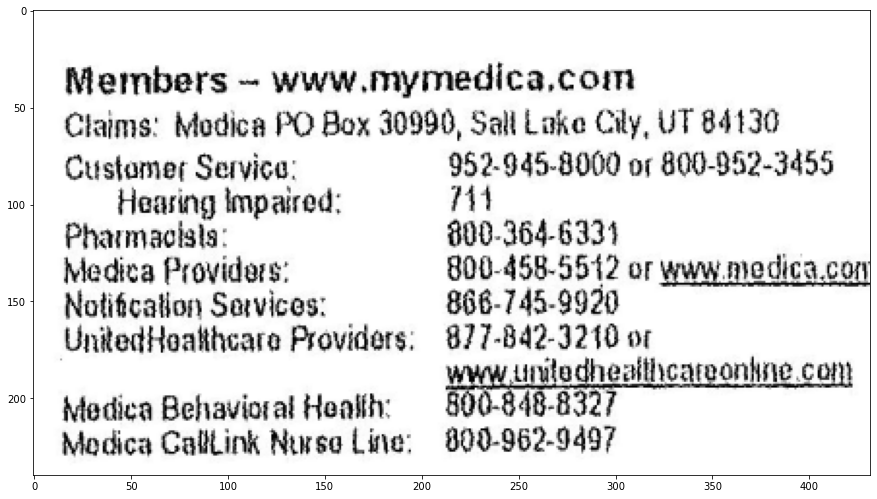

In [20]:
test_file = './sample_data/scanned_image_1.png'
resized_img = resize_image(test_file, 60)
visualize_image(resized_img)

### Upscale 

Original Dimensions :  (400, 720, 4)
Resized Dimensions :  (800, 1440, 4)


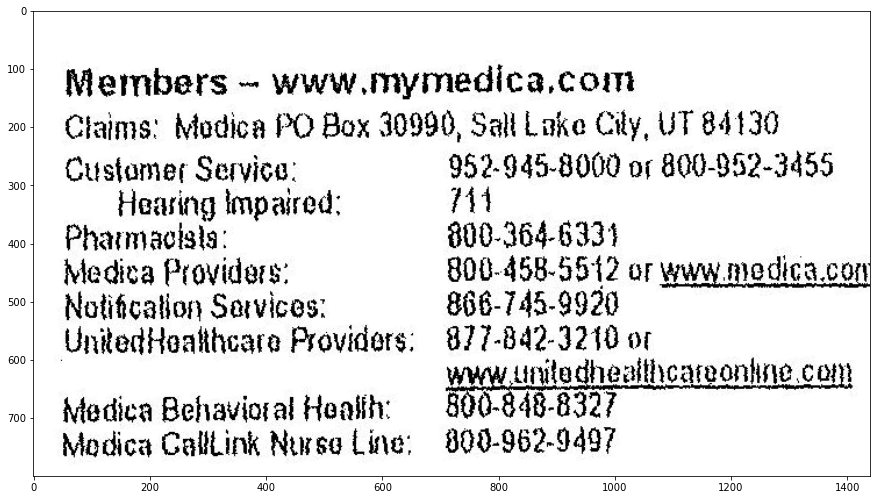

In [21]:
test_file = './sample_data/scanned_image_1.png'
resized_img = resize_image(test_file, 200)
visualize_image(resized_img)

## Blur the image

### Blur with average filters of different sizes

![title](./filters_and_transf_matrix/avg_filter.jpg)

The bigger the filter, the blurred the image.

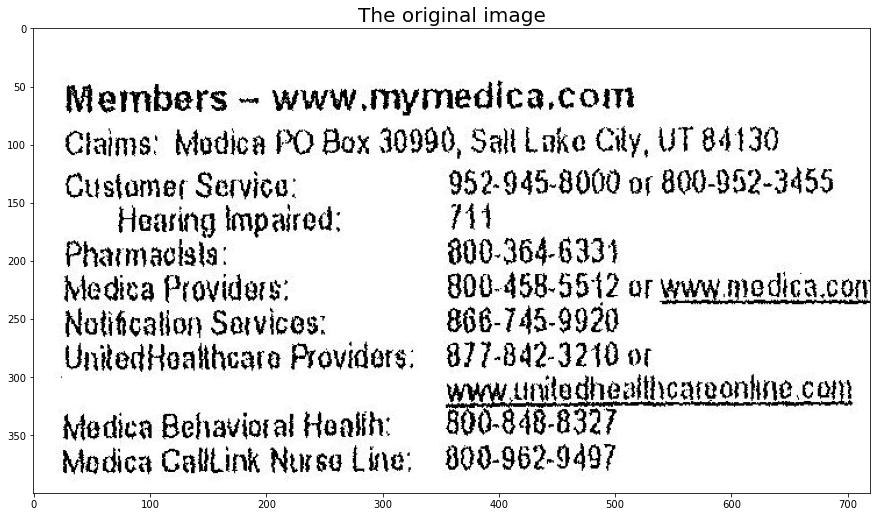

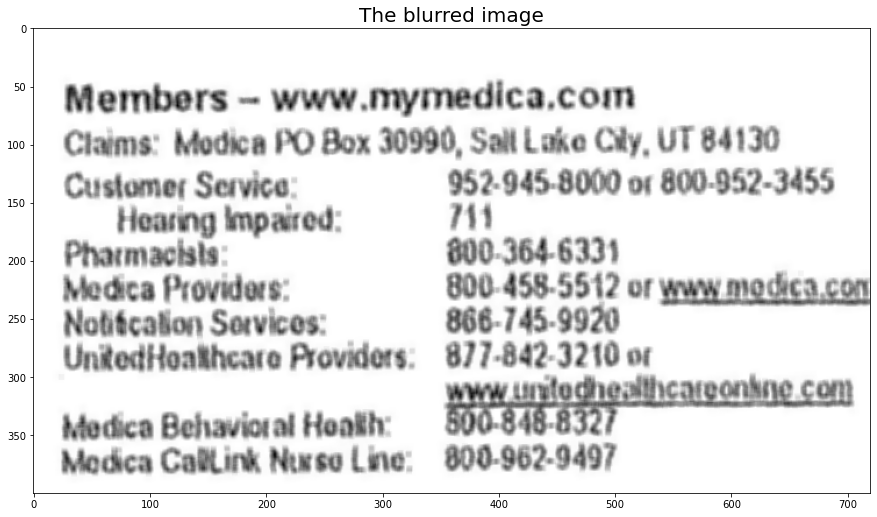

In [22]:
def blur_average(original_img, filter_size):
    return cv2.blur(original_img, filter_size)

def visualize_ariginal_blurred_in_comparison(filename, filter_size, blur_function):
    original_img = cv2.imread(filename)
    blur = blur_function(original_img, filter_size)
    visualize_image(original_img, title='The original image')
    visualize_image(blur, title='The blurred image')
    
visualize_ariginal_blurred_in_comparison(
    filename='./sample_data/scanned_image_1.png', 
    filter_size=(5,5),
    blur_function=blur_average)

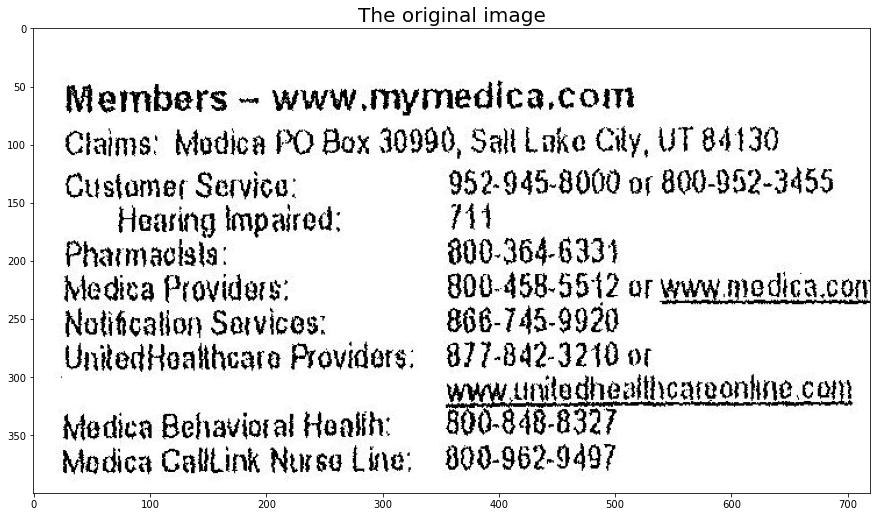

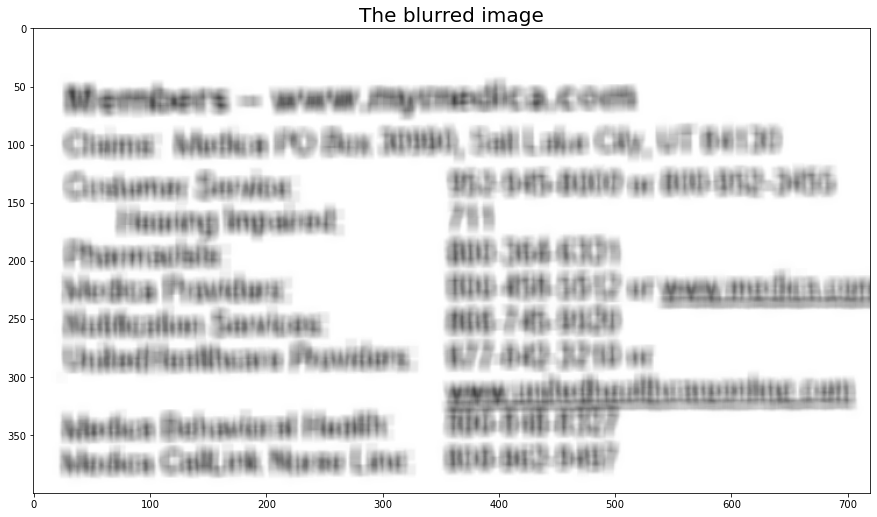

In [23]:
visualize_ariginal_blurred_in_comparison(
    filename='./sample_data/scanned_image_1.png', 
    filter_size=(10, 10),
    blur_function=blur_average)

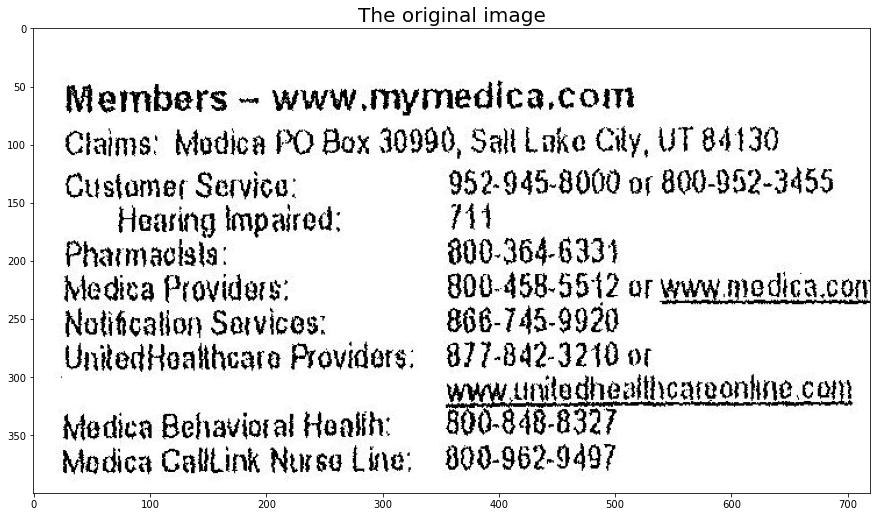

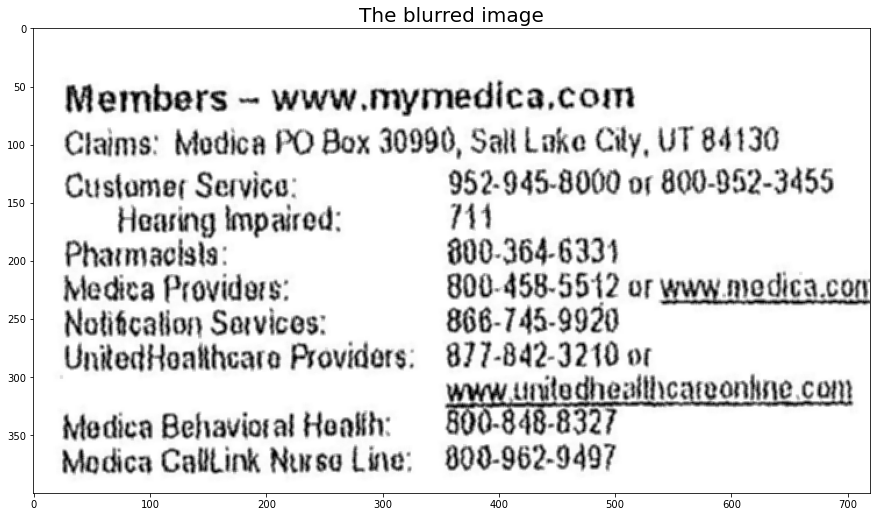

In [24]:
visualize_ariginal_blurred_in_comparison(
    filename='./sample_data/scanned_image_1.png', 
    filter_size=(3,3),
    blur_function=blur_average)

### Blur with gaussian filter

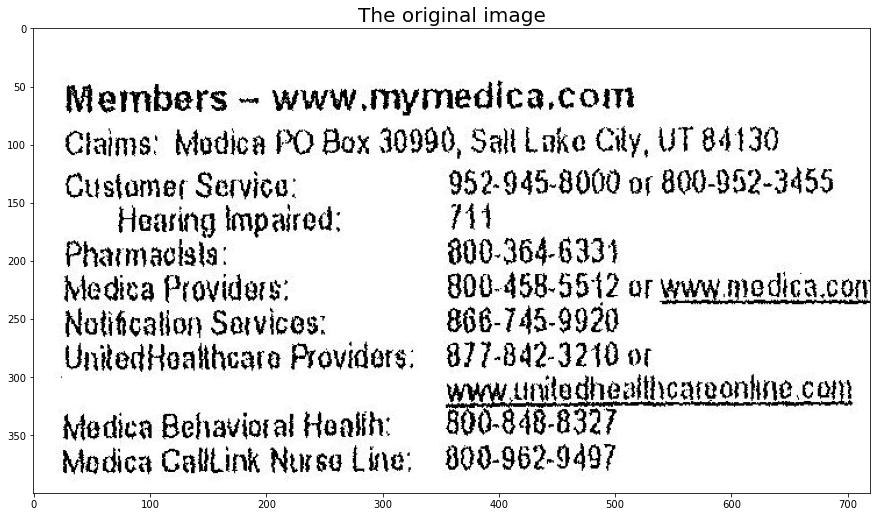

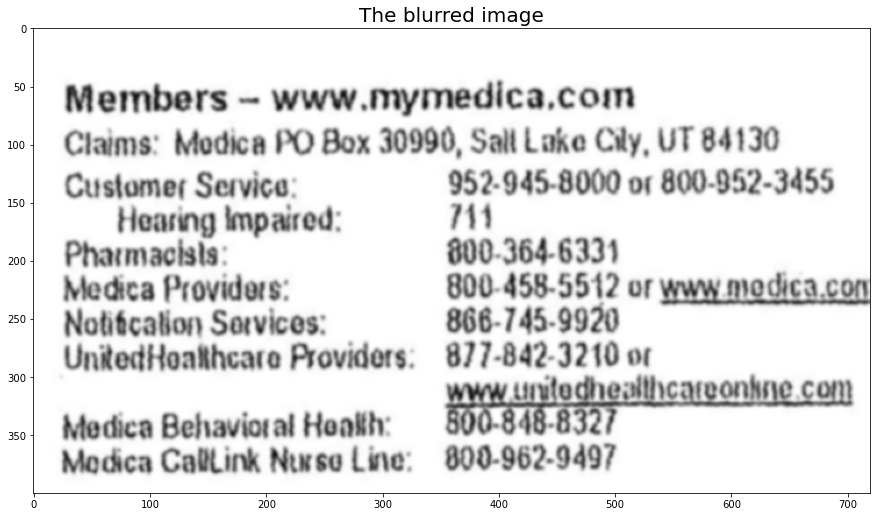

In [25]:
def gaussian_blur(original_img, filter_size):
    return cv2.GaussianBlur(original_img, filter_size, 0)

visualize_ariginal_blurred_in_comparison(
    filename='./sample_data/scanned_image_1.png', 
    filter_size=(7,7),
    blur_function=gaussian_blur)

## Text retrieval using Pytesseract

In [26]:
original_img = cv2.imread('./sample_data/scanned_image_1.png', 0)
print(pytesseract.image_to_string(original_img))

Members - www.mymedica,com
Claims: Medica PO Box 30990, Salt Lake Cily, UT 84130

Custamer Service: 952-945-8000 of 800-952-3455
Heasing impaired: “44

Pharmacista: 800-364-6934

Mediza Providers: 800-458-5512 or www.medica.con

Notifcation Services: 866-745-9920

UnitedHoaliheare Providers; 877-342-3210 or

pee unitedhealthcareonine com
Medica Behavioral Hall: 800-848-8327

Medica CallLink Nurse Line: 809-962-9497



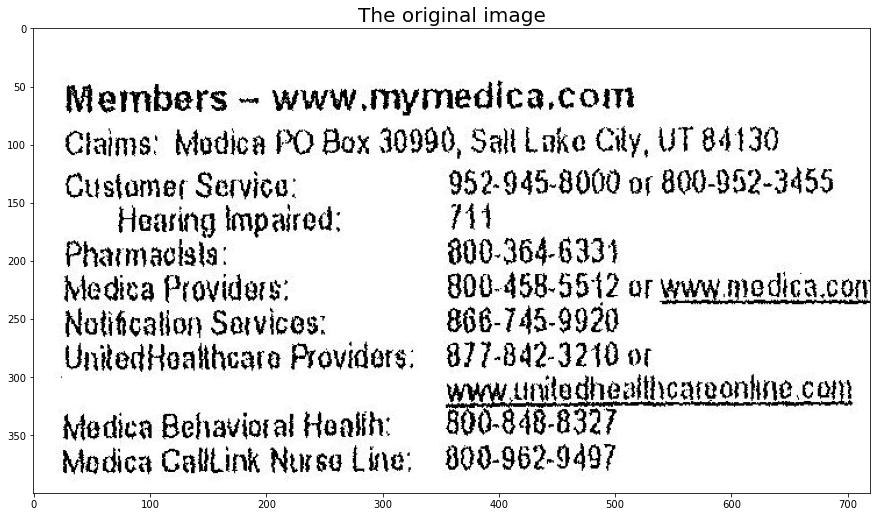

Members - www.mymedica,com
Claims: Medica PO Box 30990, Salt Lake Cily, UT 84130

Custamer Service: 952-945-8000 of 800-952-3455
Heasing impaired: “44

Pharmacista: 800-364-6934

Mediza Providers: 800-458-5512 or www.medica.con

Notifcation Services: 866-745-9920

UnitedHoaliheare Providers; 877-342-3210 or

pee unitedhealthcareonine com
Medica Behavioral Hall: 800-848-8327

Medica CallLink Nurse Line: 809-962-9497



In [27]:
original_img = cv2.imread('./sample_data/scanned_image_1.png', 0)
visualize_image(original_img, title='The original image')
print(pytesseract.image_to_string(original_img))

In [28]:
def get_text_from_image(filename, show_original=False):
    original_img = cv2.imread(filename, 0)
    if show_original:
        visualize_image(original_img, title='The original image')
    return pytesseract.image_to_string(original_img)

## Evaluate the output

### Correct words detection: Spacy lang detection + some nlp processing techniques

In [29]:
def remove_punctuation(text):
    return re.sub(r'[^\w\s]', ' ', text)

def split_text_into_words(text):
    text = remove_punctuation(text.lower())
    return word_tokenize(text)

In [30]:
remove_punctuation('12145, 672 text default!')

'12145  672 text default '

In [31]:
split_text_into_words('12145, 672 text it\'s default!')

['12145', '672', 'text', 'it', 's', 'default']

In [32]:
def evaluate_language_correction(filename, show_original=False, verbose=False):
    text_retrieved = get_text_from_image(filename, )
    words = split_text_into_words(text_retrieved)

    no_of_correct_tokens = 0
    correct_tokens = []
    for word in words:
        current_nlp_analysis = nlp(word)
        if current_nlp_analysis._.language['language'] in ['en', 'de', 'da', 'id']:
            no_of_correct_tokens += 1
            correct_tokens.append(word)
        elif word.isnumeric():
            no_of_correct_tokens += 1
    
    acc = no_of_correct_tokens / len(words) * 100
    if verbose:
        print(correct_tokens)
    
    print(str(acc) + "% correct tokens")
    return acc

evaluate_language_correction('./sample_data/scanned_image_1.png', show_original=True,
                             verbose=True)

['members', 'cily', 'service', 'of', 'heasing', 'impaired', 'or', 'services', 'unitedhoaliheare', 'providers', 'or', 'unitedhealthcareonine']
59.09090909090909% correct tokens


59.09090909090909

### Correct words detection: Pyspellchecker

In [33]:
def evaluate_spelling_from_ocr(filename, verbose=False):
    spell = SpellChecker()
    text_retrieved = get_text_from_image(filename, show_original=False)
    words = split_text_into_words(text_retrieved)
    value_counts = dict(Counter(words))

    # find those words that may be misspelled
    misspelled = spell.unknown(words)
    no_of_misspelled = 0

    for word in misspelled:
        no_of_misspelled += value_counts[word]
        if verbose:
            print("Current word: ", word)
            print("Most likely to be: ", spell.correction(word))
            print()
    
    acc = 100 - (no_of_misspelled / len(words) * 100)
    print(str(acc) + "% correct tokens")
    return acc

evaluate_spelling_from_ocr('./sample_data/scanned_image_1.png', verbose=True)

Current word:  custamer
Most likely to be:  customer

Current word:  heasing
Most likely to be:  hearing

Current word:  mediza
Most likely to be:  media

Current word:  www
Most likely to be:  wow

Current word:  pharmacista
Most likely to be:  pharmacist

Current word:  mymedica
Most likely to be:  medica

Current word:  notifcation
Most likely to be:  notification

Current word:  cily
Most likely to be:  city

Current word:  unitedhealthcareonine
Most likely to be:  unitedhealthcareonine

Current word:  unitedhoaliheare
Most likely to be:  unitedhoaliheare

Current word:  calllink
Most likely to be:  calling

81.81818181818181% correct tokens


81.81818181818181

### Comparing Spacy with SpellChecker

In [34]:
evaluate_spelling_from_ocr('./sample_data/scanned_image_2.png')

84.30939226519337% correct tokens


84.30939226519337

In [35]:
evaluate_language_correction('./sample_data/scanned_image_2.png', verbose=False)

39.889502762430936% correct tokens


39.889502762430936

In [36]:
evaluate_spelling_from_ocr('./sample_data/scanned_image_3.jpg')

72.61904761904762% correct tokens


72.61904761904762

In [37]:
evaluate_language_correction('./sample_data/scanned_image_3.jpg', verbose=False)

25.396825396825395% correct tokens


25.396825396825395

In [38]:
evaluate_spelling_from_ocr('./sample_data/dip_gw_1.jpg')

90.4% correct tokens


90.4

In [39]:
evaluate_language_correction('./sample_data/dip_gw_1.jpg', verbose=False)

44.0% correct tokens


44.0

## Image enhancement processing techniques

In [40]:
def visualize_original_vs_modified(original_img, modified):
    visualize_image(original_img, title='ORIGINAL')
    visualize_image(modified, title='MODIFIED')

In [41]:
original_img = cv2.imread('./sample_data/scanned_image_1.png', 0)

### Sharpening

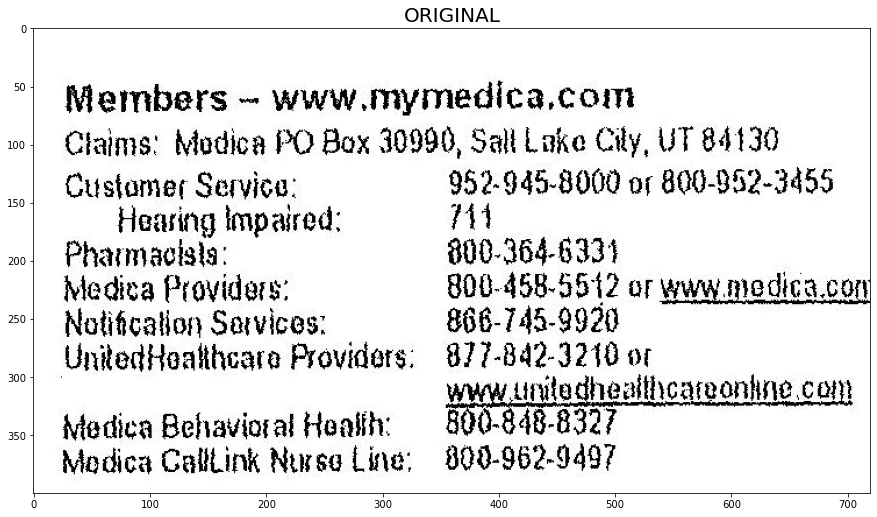

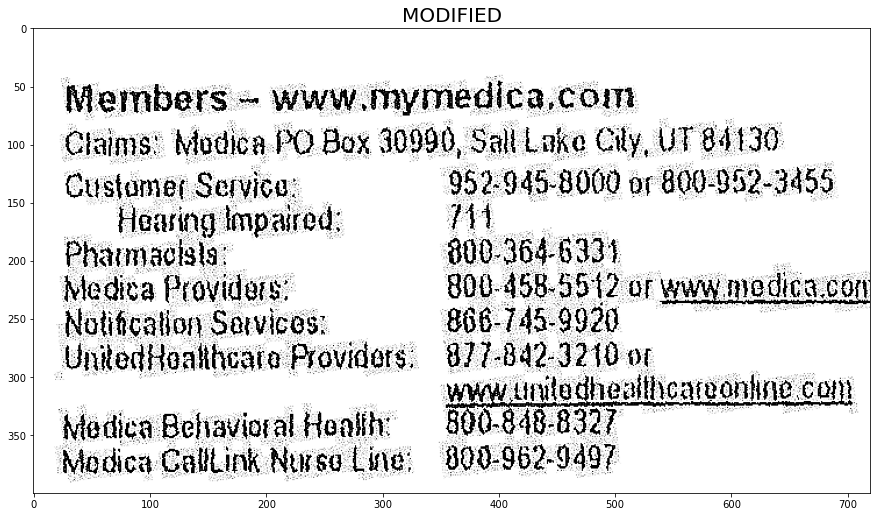

In [42]:
# noise removal
def remove_noise(image):
    return cv2.medianBlur(image,5)

def sharpen_image(image):
    filter_2d = np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]])
    sharpen_img = cv2.filter2D(image, -1, filter_2d)
    return sharpen_img

modified_img = sharpen_image(original_img)
visualize_original_vs_modified(original_img, modified_img)

### Thresholding techniques

In [43]:
original_img = cv2.imread('./sample_data/scanned_image_2.png', 0)

In [44]:
def thresholding_binary_inv(image):
    return cv2.threshold(image, 120, 255, cv2.THRESH_BINARY_INV)[1]

def thresholding_to_zero(image):
    return cv2.threshold(image, 120, 255, cv2.THRESH_TOZERO)[1] 

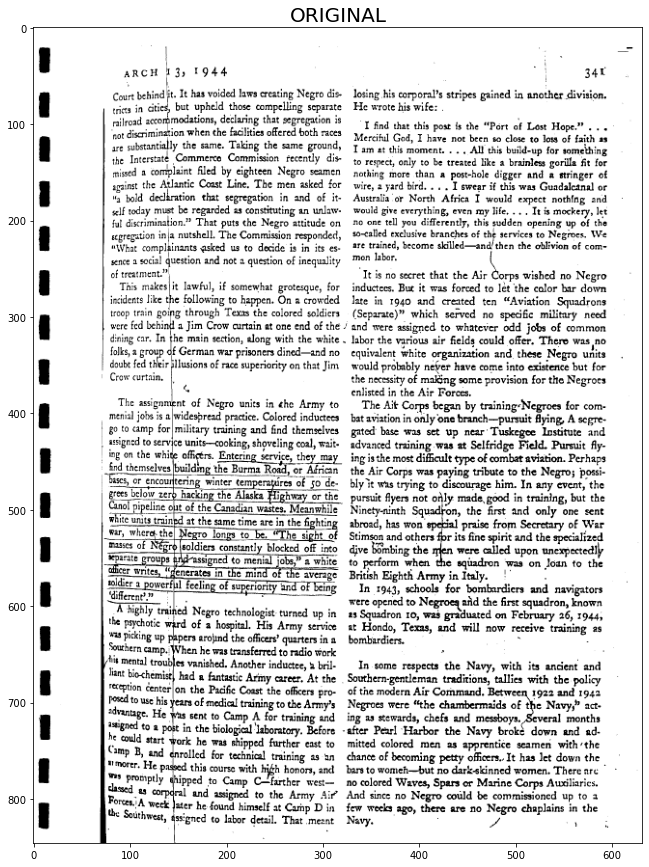

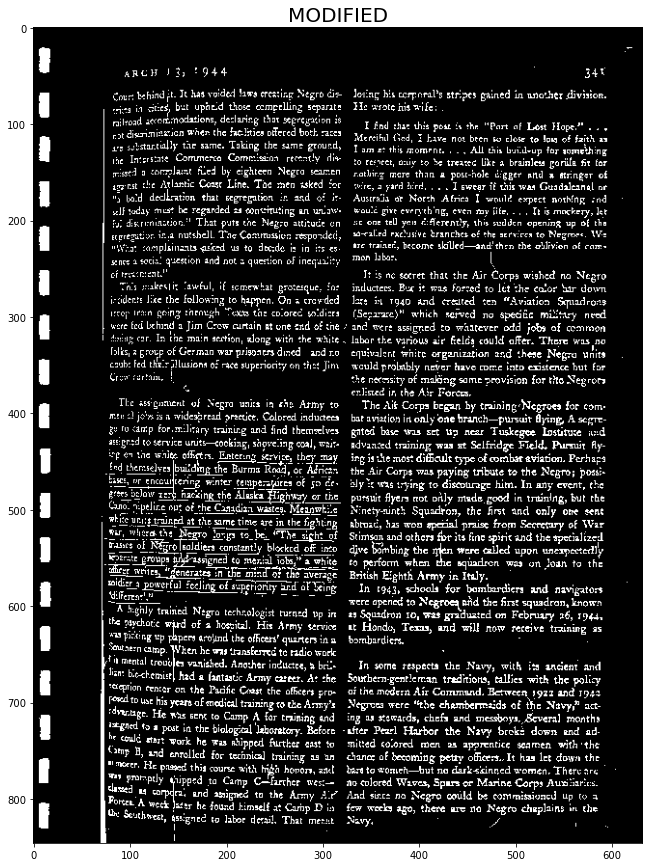

In [45]:
modified_img = thresholding_binary_inv(original_img)
visualize_original_vs_modified(original_img, modified_img)

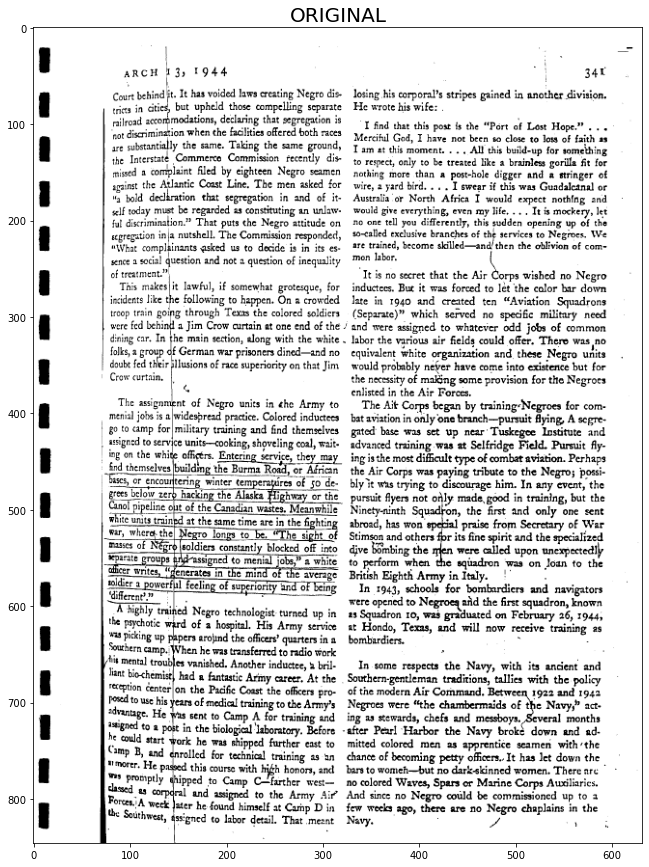

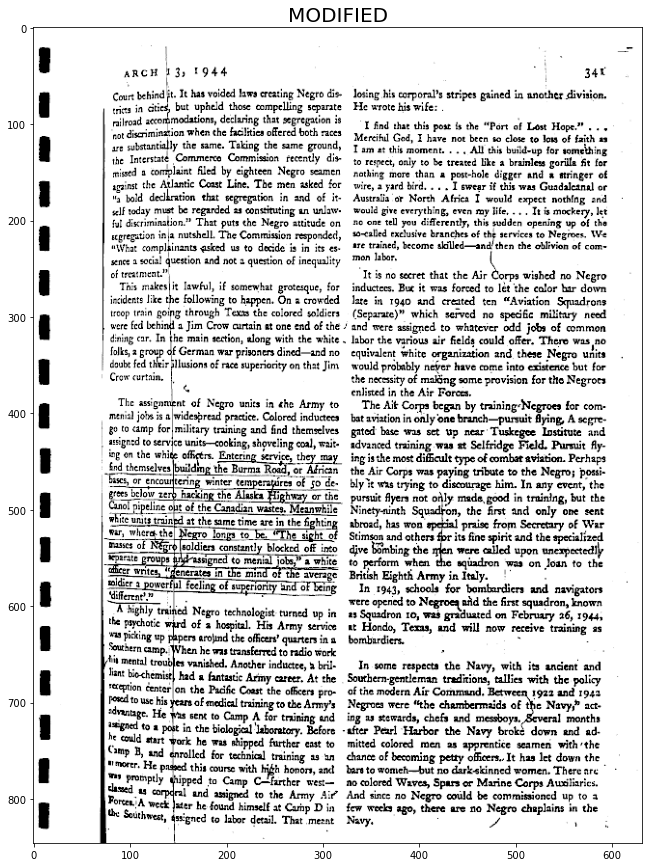

In [46]:
modified_img = thresholding_to_zero(original_img)
visualize_original_vs_modified(original_img, modified_img)

In [48]:
# closed_img = opening(original_img, (2, 2))
# visualize_original_vs_modified(original_img, closed_img)

### Morphological operations

In [49]:
# dilation
def dilate(image, kernel_size):
    kernel = np.ones(kernel_size,np.uint8)
    return cv2.dilate(image, kernel, iterations = 1)
    
# erosion
def erode(image, kernel_size):
    kernel = np.ones(kernel_size,np.uint8)
    return cv2.erode(image, kernel, iterations = 1)

# opening - erosion followed by dilation
def opening(image, kernel_size):
    kernel = np.ones(kernel_size,np.uint8)
    return cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)

# opening - dilation followed by erosion
def closing(image, kernel_size):
    kernel = np.ones(kernel_size,np.uint8)
    return cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)

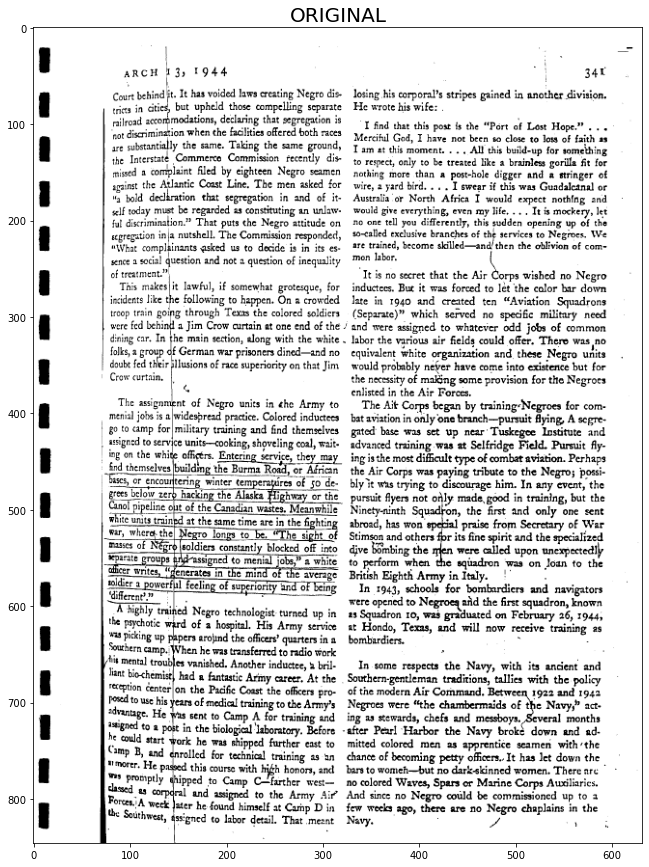

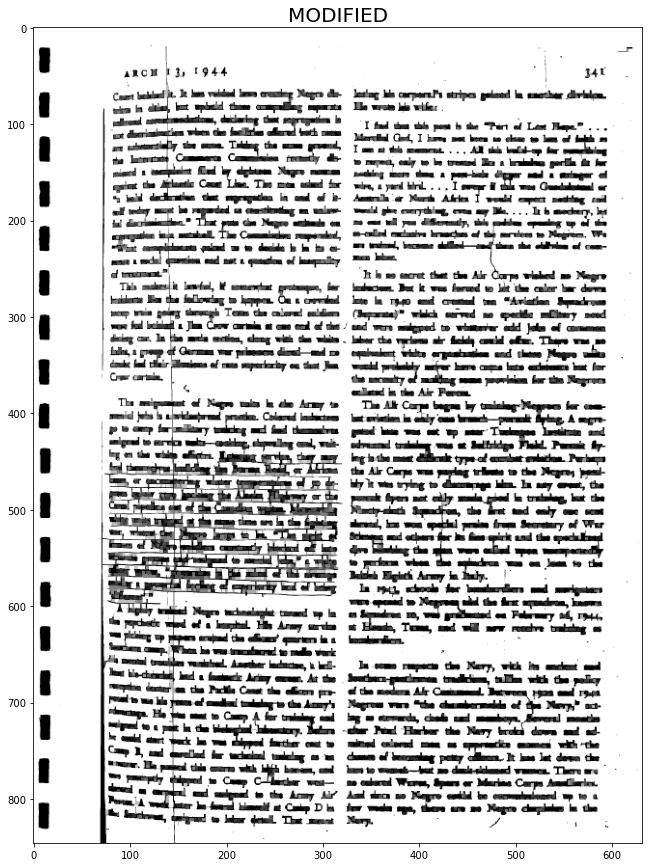

In [50]:
opened_img = opening(original_img, (3, 3))
visualize_original_vs_modified(original_img, opened_img)

## References

1. **Gaussian Blur**: https://en.wikipedia.org/wiki/Gaussian_blur
2. **Affine transformations**: https://stackabuse.com/affine-image-transformations-in-python-with-numpy-pillow-and-opencv/
3. **Salt and pepper noise**: https://stackoverflow.com/questions/22937589/how-to-add-noise-gaussian-salt-and-pepper-etc-to-image-in-python-with-opencv